# Analyse des données

In [2]:
# paths

TEST_DIR = '/kaggle/input/nfl-player-contact-detection/test'
TRAIN_DIR = '/kaggle/input/nfl-player-contact-detection/train'

TEST_BASELINE_HELMETS = '/kaggle/input/nfl-player-contact-detection/test_baseline_helmets.csv'
TRAIN_BASELINE_HELMETS = '/kaggle/input/nfl-player-contact-detection/train_baseline_helmets.csv'

TEST_PLAYER_TRACKING = '/kaggle/input/nfl-player-contact-detection/test_player_tracking.csv'
TRAIN_PLAYER_TRACKING = '/kaggle/input/nfl-player-contact-detection/train_player_tracking.csv'

TEST_VIDEO_METADATA = '/kaggle/input/nfl-player-contact-detection/test_video_metadata.csv'
TRAIN_VIDEO_METADATA = '/kaggle/input/nfl-player-contact-detection/train_video_metadata.csv'

TRAIN_LABELS = '/kaggle/input/nfl-player-contact-detection/train_labels.csv'
SAMPLE_SUBMISSION = '/kaggle/input/nfl-player-contact-detection/sample_submission.csv'

## Imports

In [3]:
import sys
sys.path.append('/kaggle/input/fasteda')

In [4]:
from fasteda import fast_eda
import pandas as pd

In [5]:
players_df = pd.read_csv(TRAIN_PLAYER_TRACKING, parse_dates=["datetime"])
helmets_df = pd.read_csv(TRAIN_BASELINE_HELMETS)
labels_df = pd.read_csv(TRAIN_LABELS, parse_dates=["datetime"])
video_metadata_df = pd.read_csv(TEST_VIDEO_METADATA, parse_dates=["start_time", "end_time", "snap_time"])

## Données joueurs

In [6]:
players_df.nunique()

game_play          240
game_key           149
play_id            233
nfl_player_id     1687
datetime         61279
step              1032
team                 2
position            28
jersey_number       99
x_position       12295
y_position        6893
speed             1057
distance           144
direction        36001
orientation      36001
acceleration       840
sa                1504
dtype: int64

DataFrame Head:


,game_play,game_key,play_id,nfl_player_id,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa
0,58580_001136,58580,1136,44830,-108,away,CB,22,61.59,42.60,1.11,0.11,320.33,263.93,0.71,-0.64
1,58580_001136,58580,1136,47800,-108,away,DE,97,59.48,26.81,0.23,0.01,346.84,247.16,1.29,0.90
2,58580_001136,58580,1136,52444,-108,away,FS,29,72.19,31.46,0.61,0.06,11.77,247.69,0.63,-0.33


DataFrame Tail:


,game_play,game_key,play_id,nfl_player_id,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa
1353050,58575_003081,58575,3081,44174,140,away,ILB,49,74.54,55.75,1.12,0.11,352.79,349.20,0.63,0.46
1353051,58575_003081,58575,3081,45217,140,away,TE,82,80.44,48.77,1.93,0.20,340.78,346.51,0.53,-0.51
1353052,58575_003081,58575,3081,43757,140,home,SS,26,110.56,24.05,2.64,0.27,231.91,230.50,0.46,-0.41


----------------------------------------------------------------------------------------------------
Missing values:


,0


----------------------------------------------------------------------------------------------------
Shape of DataFrame:

(1353053, 16)

----------------------------------------------------------------------------------------------------
DataFrame Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1353053 entries, 0 to 1353052
Data columns (total 16 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   game_play      1353053 non-null  object 
 1   game_key       1353053 non-null  int64  
 2   play_id        1353053 non-null  int64  
 3   nfl_player_id  1353053 non-null  int64  
 4   step           1353053 non-null  int64  
 5   team           1353053 non-null  object 
 6   position       1353053 non-null  object 
 7   jersey_number  1353053 non-null  int64  
 8   x_position     1353053 non-null  float64
 9   y_position     1353053 non-null  float64
 10  speed          1353053 non-null  float64
 11  distance       1353053 non-nu

,count,mean,median,std,min,25%,50%,75%,max,skewness,kurtosis
game_key,1353053,58365.799,58330,137.696,58168,58225,58330,58516,58582,0.184571,-1.518110
play_id,1353053,2156.408,2369,1211.457,40,1016,2369,3139,4644,-0.121913,-1.147967
nfl_player_id,1353053,44747.017,44893,4831.883,25511,42352,44893,47814,53985,-0.336884,0.738855
step,1353053,-11.9,-15,112.549,-339,-86,-15,49,692,1.186454,4.607197
jersey_number,1353053,51.282,52,28.636,1,25,52,76,99,0.043242,-1.277333
x_position,1353053,60.308,59.69,26.815,-7.47,38.48,59.69,81.71,125.65,0.043911,-1.014410
y_position,1353053,26.759,26.74,8.507,-12.87,22.49,26.74,31.04,63.72,0.007982,1.182597
speed,1353053,1.26,0.65,1.658,0,0.12,0.65,1.62,14.89,2.129786,4.935417
distance,1353053,0.129,0.07,0.167,0,0.02,0.07,0.16,2.22,2.147445,5.134834
direction,1353053,179.699,179.24,104.001,0,90.03,179.24,269.33,360,0.011603,-1.178843


----------------------------------------------------------------------------------------------------
DataFrame Correlation:



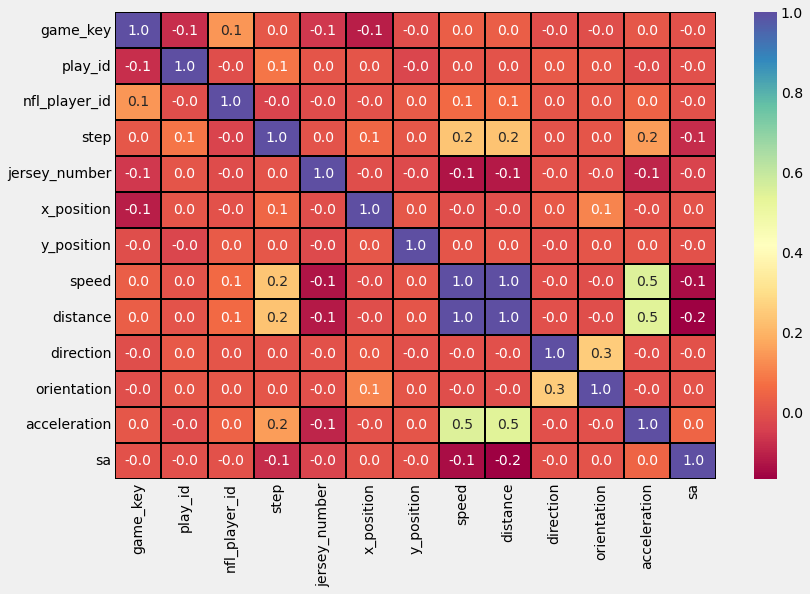

----------------------------------------------------------------------------------------------------
Histogram(s) & Boxplot(s):



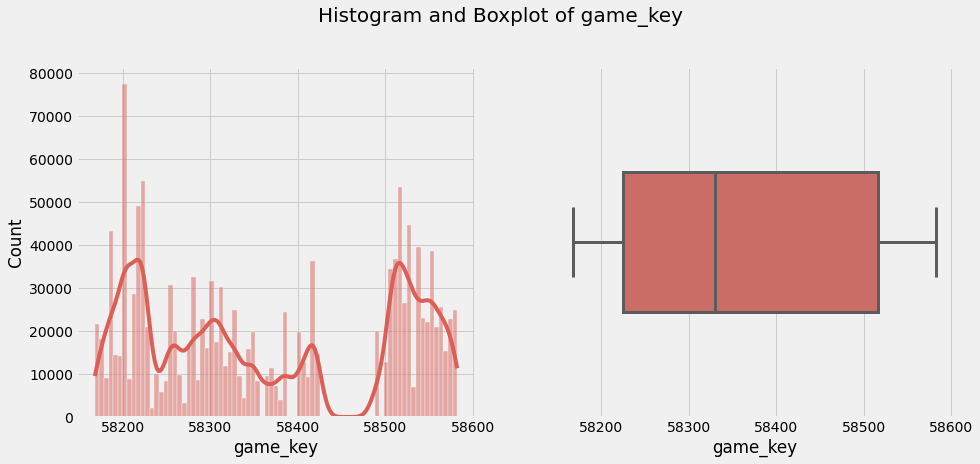

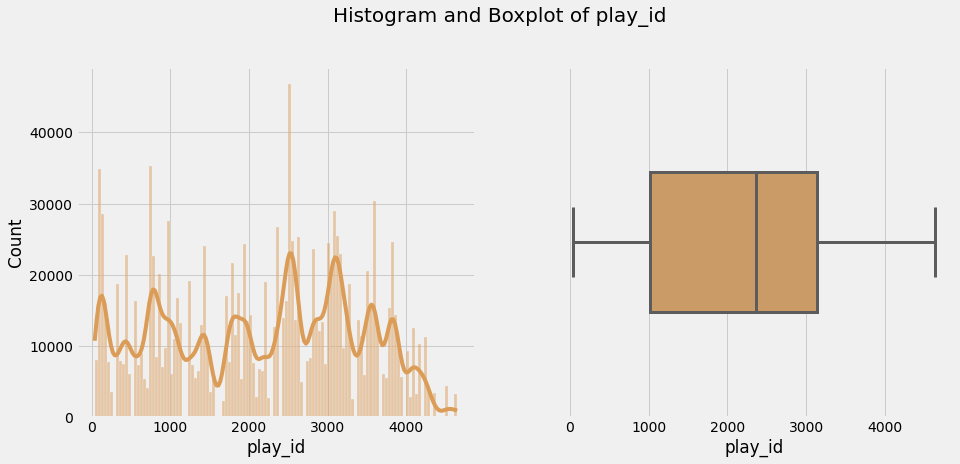

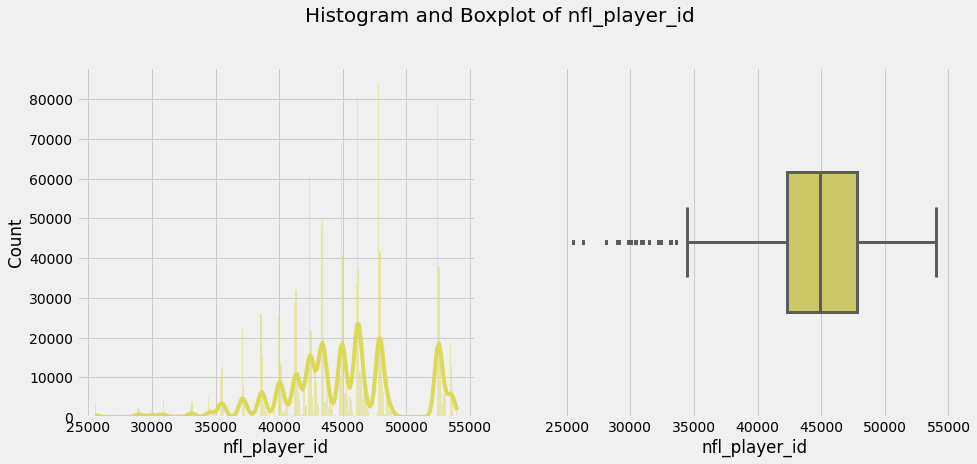

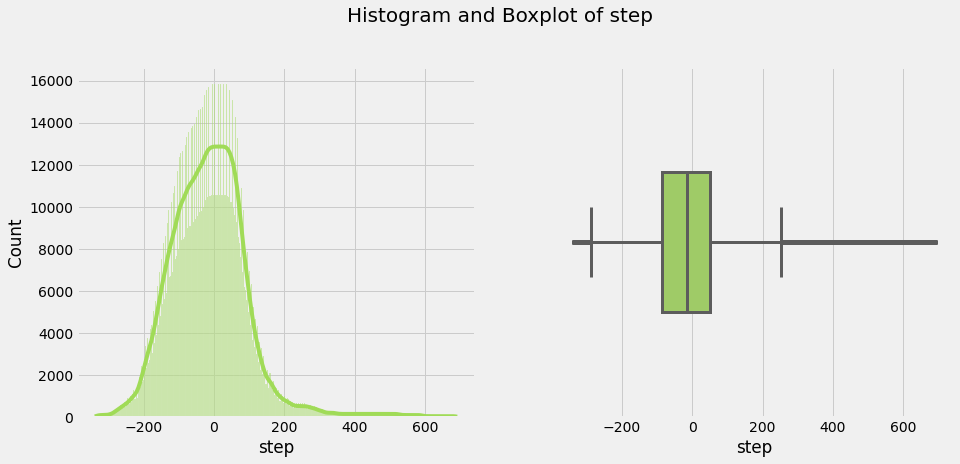

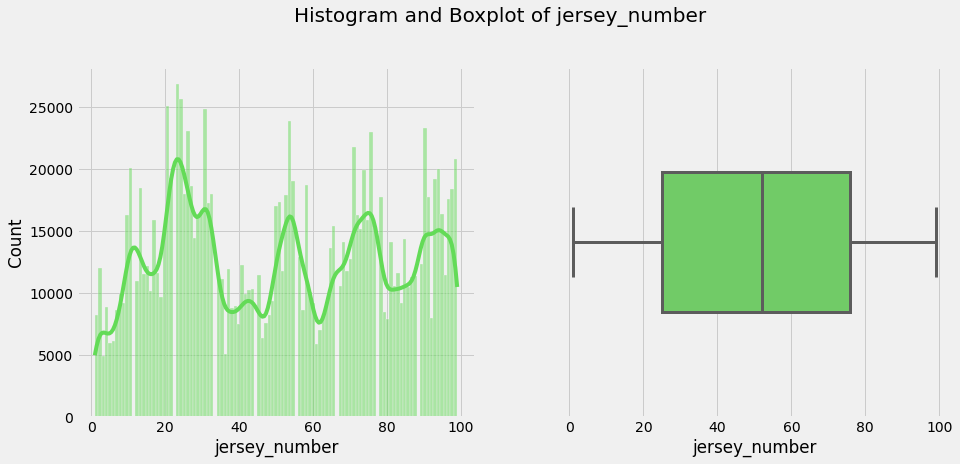

...

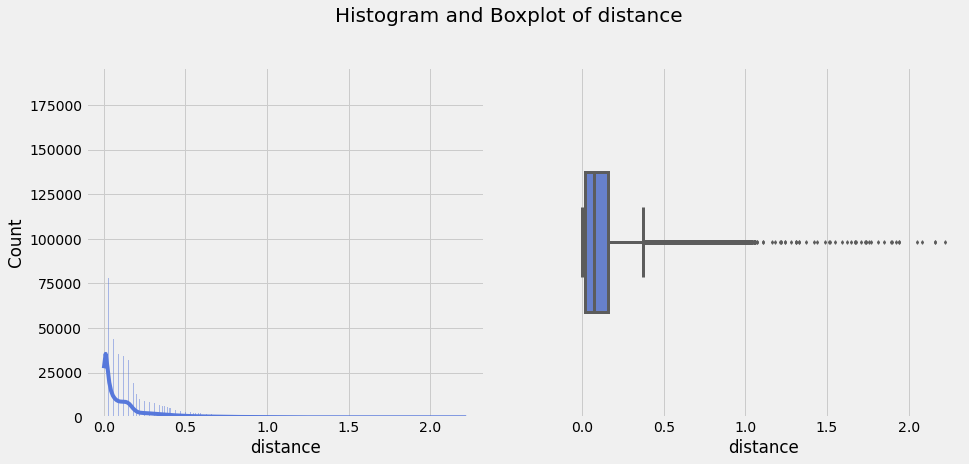

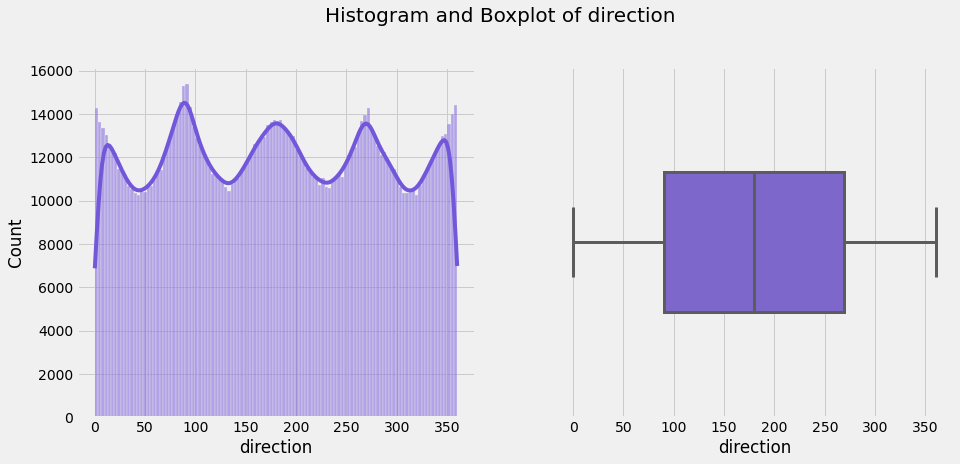

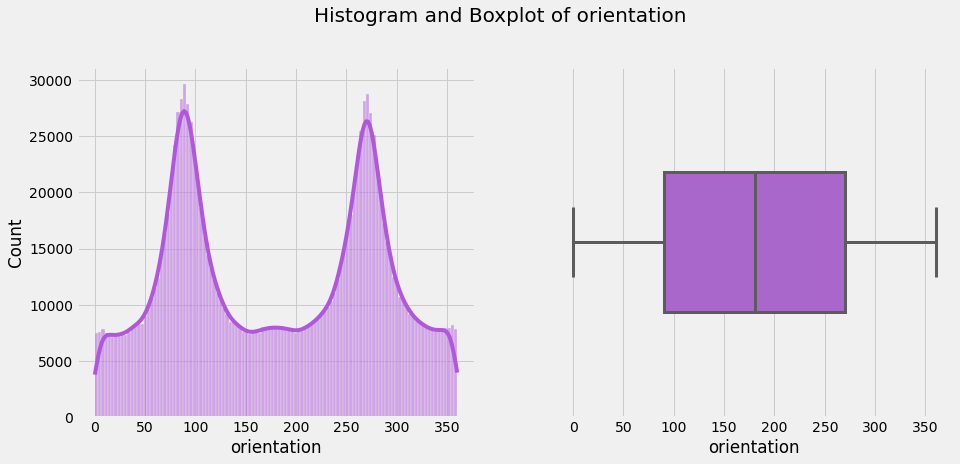

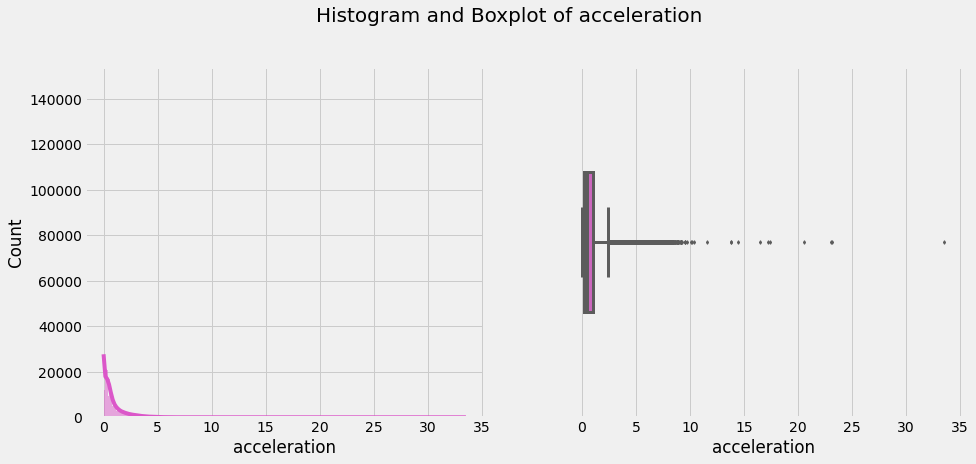

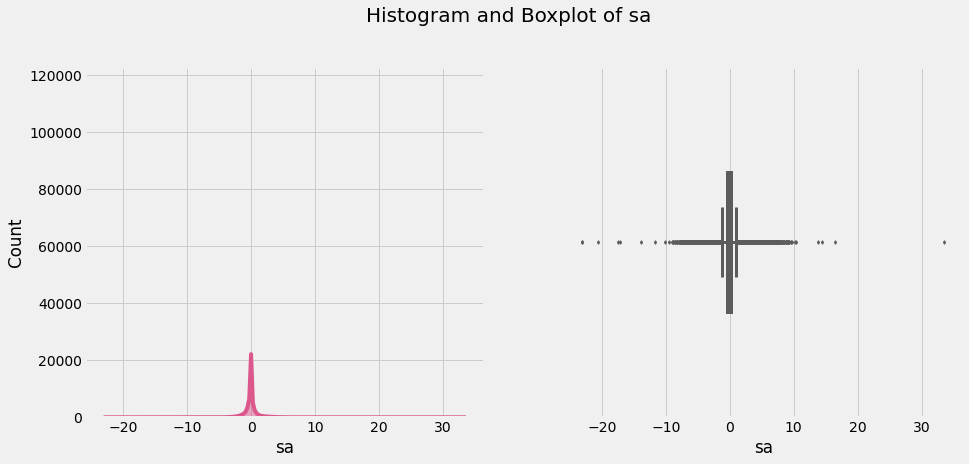

----------------------------------------------------------------------------------------------------
Countplot(s):



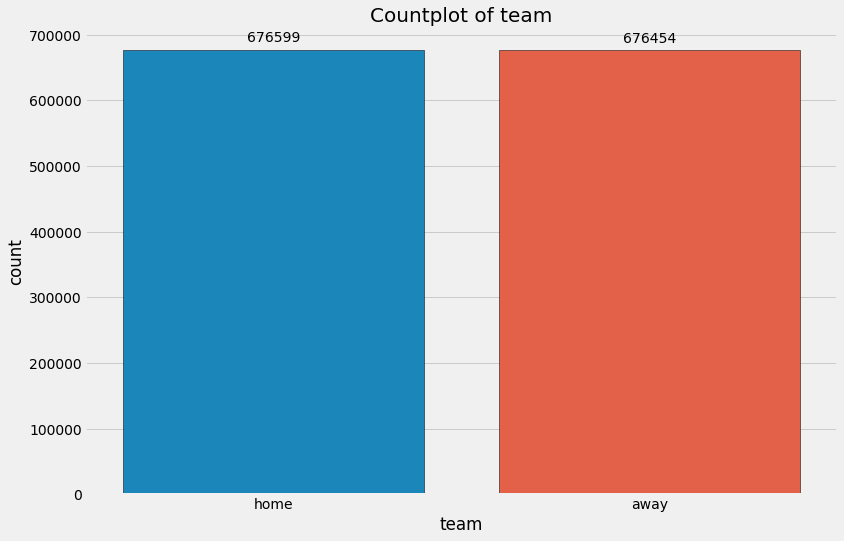

In [7]:
fast_eda(players_df.drop(["datetime"], axis=1))

## Données casques

DataFrame Head:


,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height
0,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,39947,H72,946,25,293,34
1,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,37211,H42,151,25,267,33
2,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,38590,H70,810,25,293,35


DataFrame Tail:


,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height
3783613,58582_003121,58582,3121,Sideline,58582_003121_Sideline.mp4,842,45009,V97,30,29,446,23
3783614,58582_003121,58582,3121,Sideline,58582_003121_Sideline.mp4,842,46155,H89,750,18,338,26
3783615,58582_003121,58582,3121,Sideline,58582_003121_Sideline.mp4,842,36712,V42,986,25,391,26


----------------------------------------------------------------------------------------------------
Missing values:


,0


----------------------------------------------------------------------------------------------------
Shape of DataFrame:

(3783616, 12)

----------------------------------------------------------------------------------------------------
DataFrame Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3783616 entries, 0 to 3783615
Data columns (total 12 columns):
 #   Column         Dtype 
---  ------         ----- 
 0   game_play      object
 1   game_key       int64 
 2   play_id        int64 
 3   view           object
 4   video          object
 5   frame          int64 
 6   nfl_player_id  int64 
 7   player_label   object
 8   left           int64 
 9   width          int64 
 10  top            int64 
 11  height         int64 
dtypes: int64(8), object(4)
memory usage: 346.4+ MB
----------------------------------------------------------------------------------------------------
Describe DataFrame:



,count,mean,median,std,min,25%,50%,75%,max,skewness,kurtosis
game_key,3783616,58370.208,58332,139.664,58168,58227,58332,58524,58582,0.136537,-1.549046
play_id,3783616,2186.813,2375,1195.722,40,1076,2375,3151,4644,-0.125298,-1.101662
frame,3783616,517.629,497,156.907,289,392,497,617,1326,0.873122,1.049913
nfl_player_id,3783616,44926.816,44926,4762.725,25511,42372,44926,47825,53985,-0.264354,0.549442
left,3783616,629.549,632,266.543,0,444,632,815,1278,-0.016767,-0.454124
width,3783616,17.946,16,8.657,2,11,16,24,82,0.977390,0.937414
top,3783616,305.039,301,119.258,0,235,301,372,718,0.245714,0.602409
height,3783616,19.027,17,9.385,2,12,17,25,89,1.018890,0.988601


----------------------------------------------------------------------------------------------------
DataFrame Correlation:



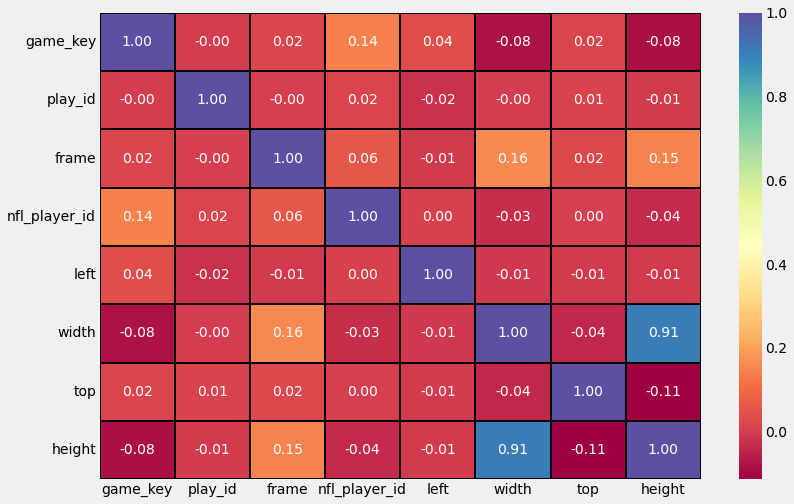

----------------------------------------------------------------------------------------------------
DataFrame Pairplot:



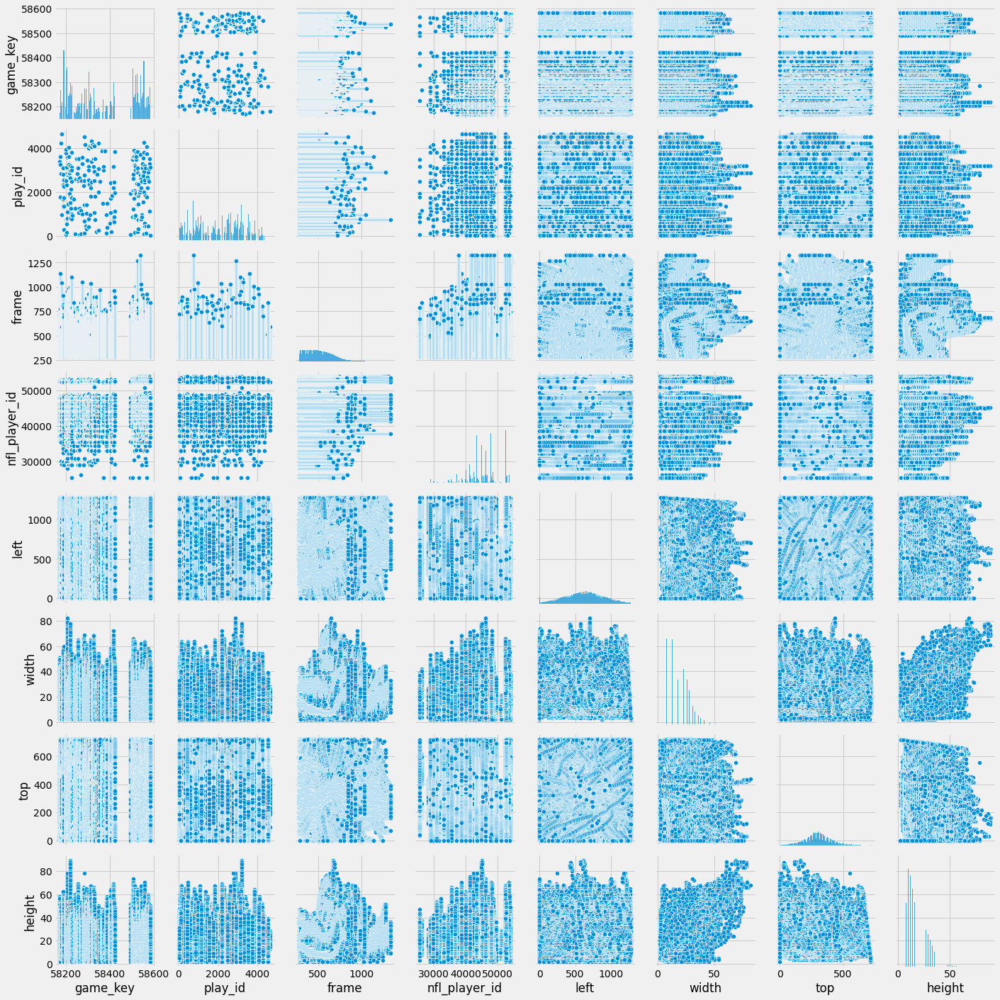

----------------------------------------------------------------------------------------------------
Histogram(s) & Boxplot(s):



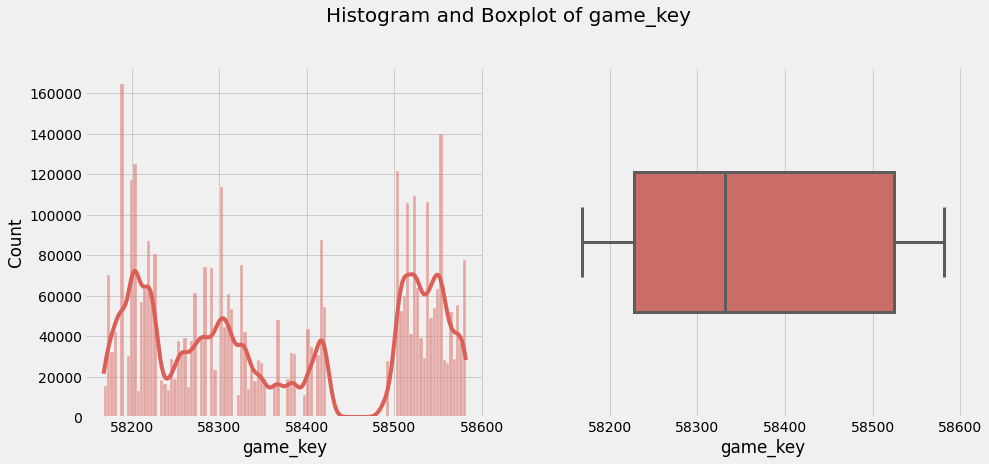

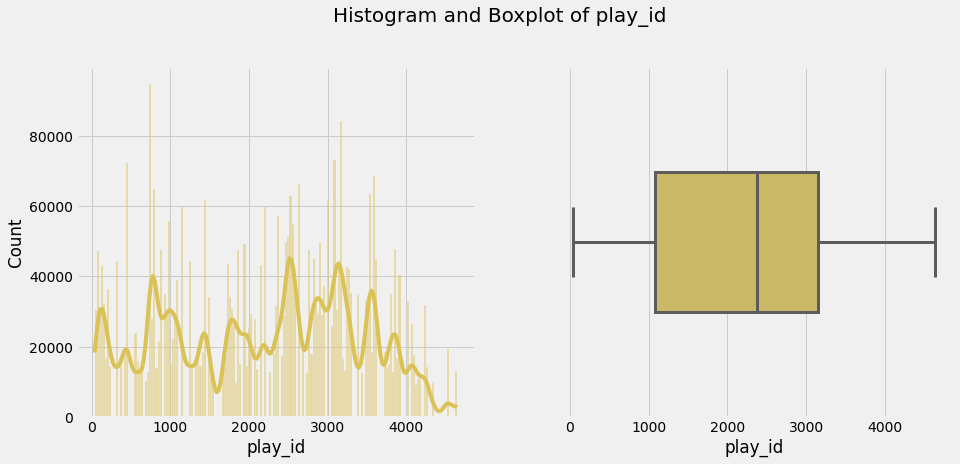

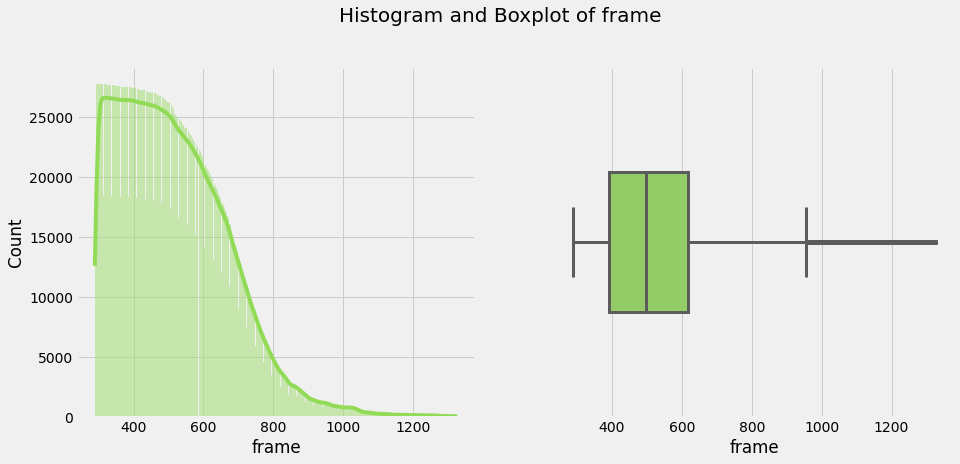

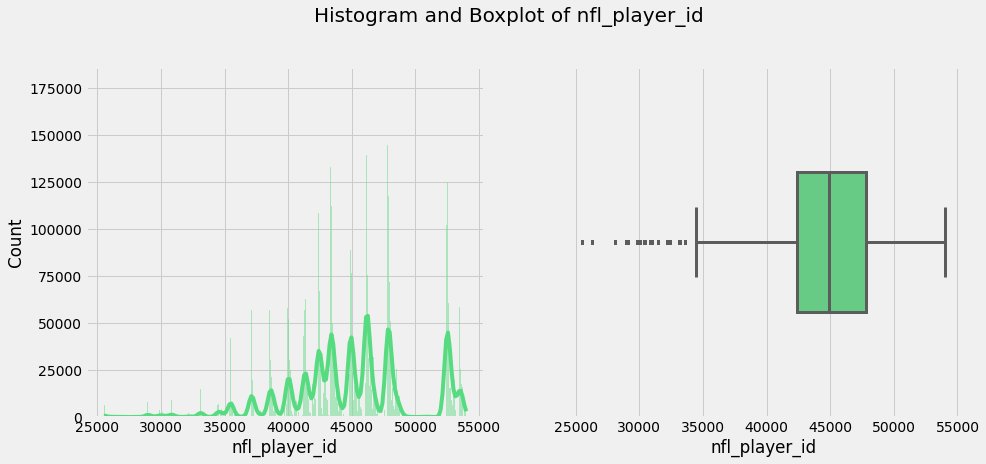

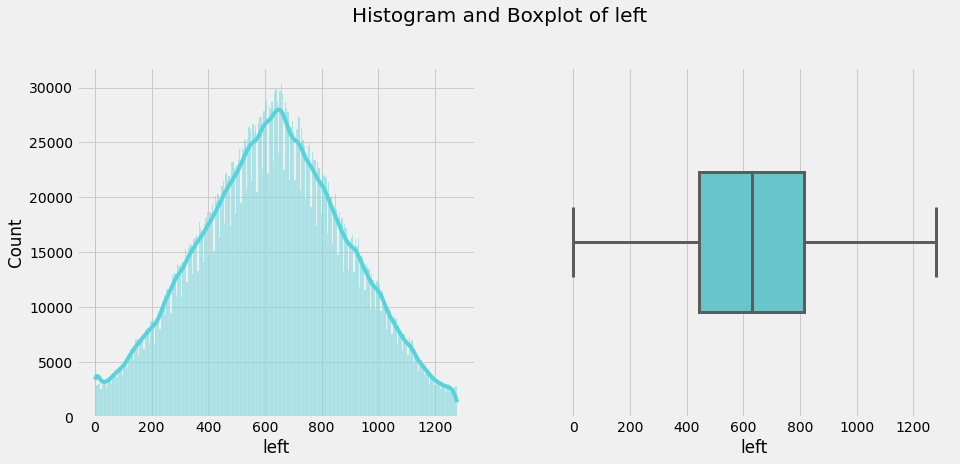

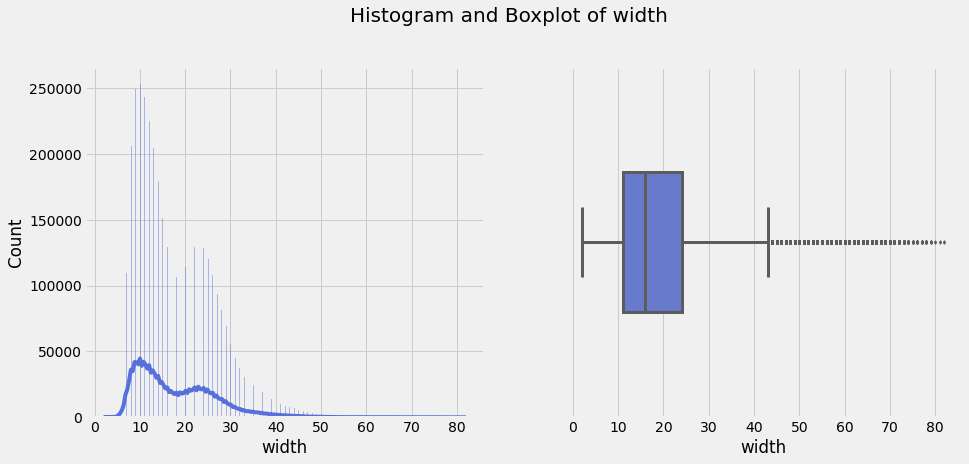

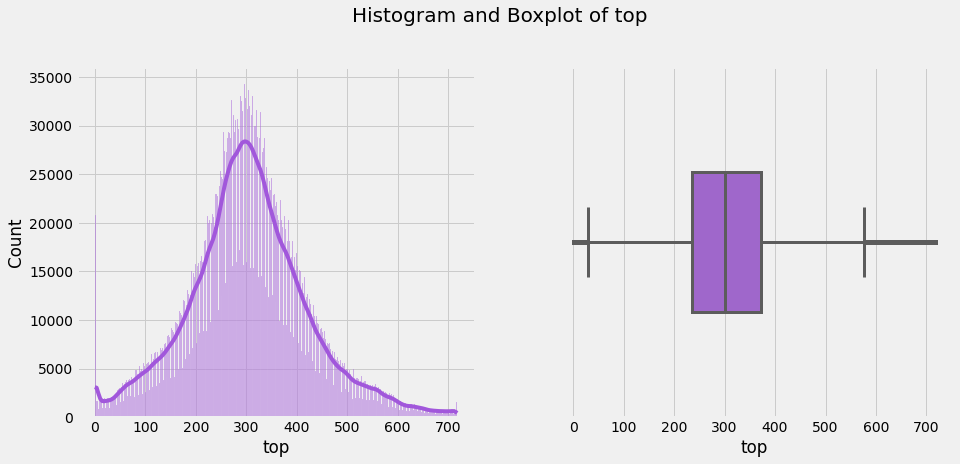

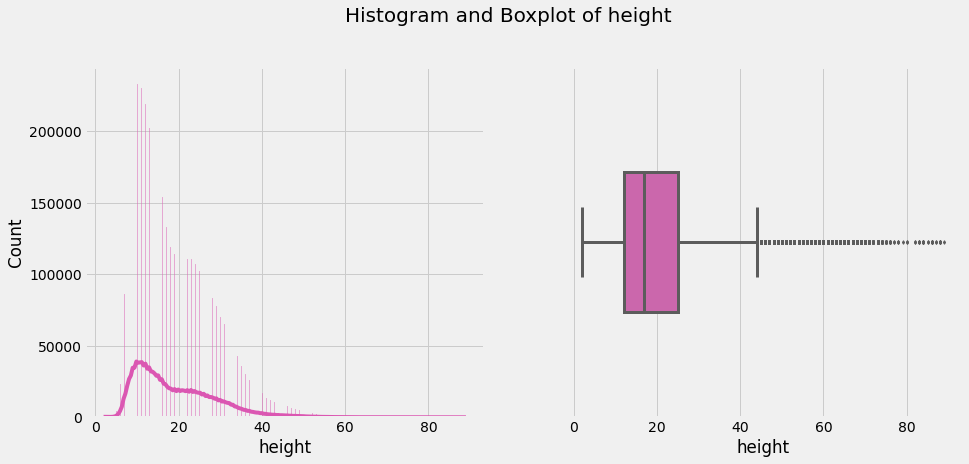

----------------------------------------------------------------------------------------------------
Countplot(s):



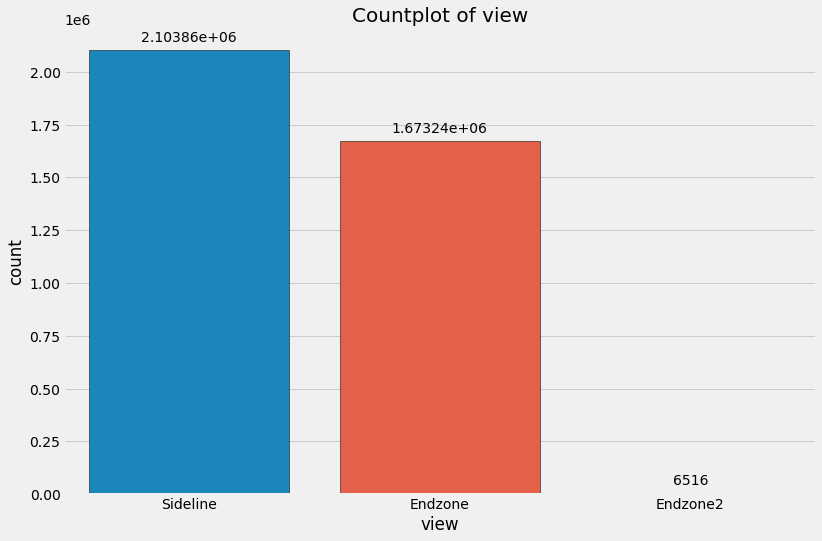

In [8]:
fast_eda(helmets_df)

## Données vidéos

DataFrame Head:


,game_play,game_key,play_id,view,start_time,end_time,snap_time
0,58168_003392,58168,3392,Endzone,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
1,58168_003392,58168,3392,Sideline,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
2,58172_003247,58172,3247,Endzone,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00


DataFrame Tail:


,game_play,game_key,play_id,view,start_time,end_time,snap_time
1,58168_003392,58168,3392,Sideline,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
2,58172_003247,58172,3247,Endzone,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00
3,58172_003247,58172,3247,Sideline,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00


----------------------------------------------------------------------------------------------------
Missing values:


,0


----------------------------------------------------------------------------------------------------
Shape of DataFrame:

(4, 7)

----------------------------------------------------------------------------------------------------
DataFrame Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype              
---  ------      --------------  -----              
 0   game_play   4 non-null      object             
 1   game_key    4 non-null      int64              
 2   play_id     4 non-null      int64              
 3   view        4 non-null      object             
 4   start_time  4 non-null      datetime64[ns, UTC]
 5   end_time    4 non-null      datetime64[ns, UTC]
 6   snap_time   4 non-null      datetime64[ns, UTC]
dtypes: datetime64[ns, UTC](3), int64(2), object(2)
memory usage: 352.0+ bytes
------------------------------------------------------------------------------------------------

,count,mean,median,std,min,25%,50%,75%,max,skewness,kurtosis
game_key,4,58170,58170,2.309,58168,58168,58170,58172,58172,0.000000,-2.000000
play_id,4,3319.5,3319.5,83.716,3247,3247,3319.5,3392,3392,0.000000,-2.000000


----------------------------------------------------------------------------------------------------
DataFrame Correlation:



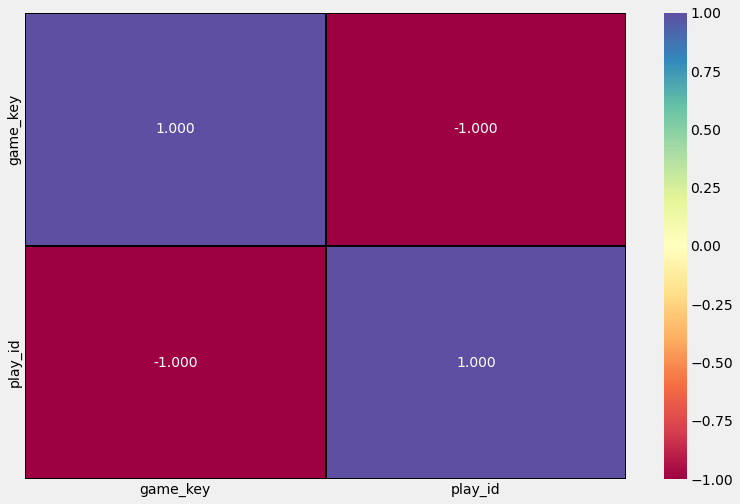

----------------------------------------------------------------------------------------------------
DataFrame Pairplot:



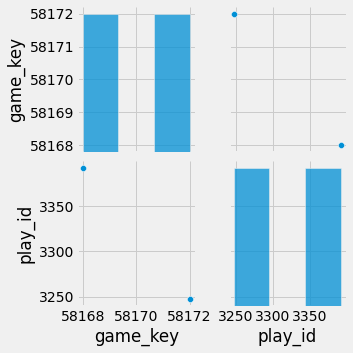

----------------------------------------------------------------------------------------------------
Histogram(s) & Boxplot(s):

----------------------------------------------------------------------------------------------------
Countplot(s):



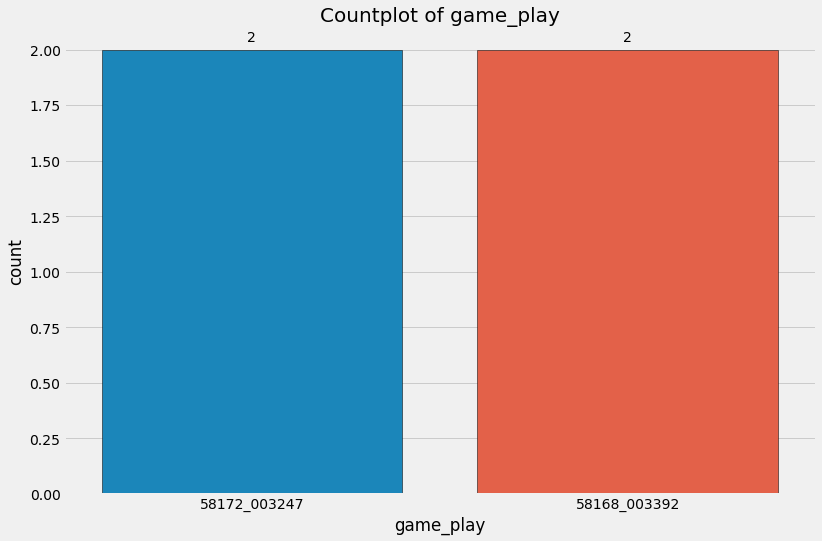

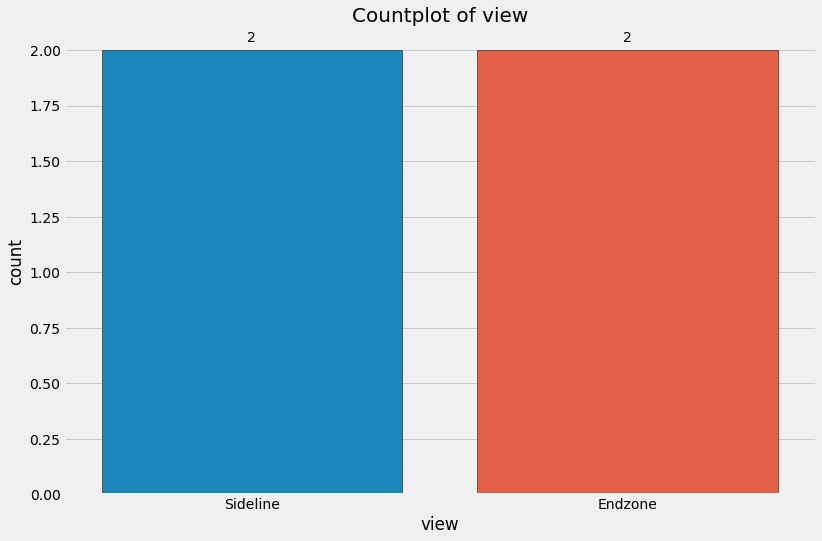

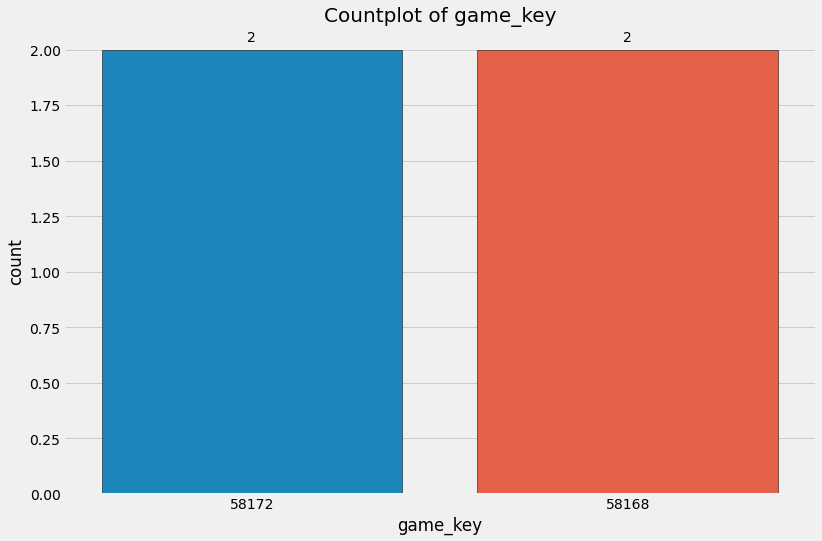

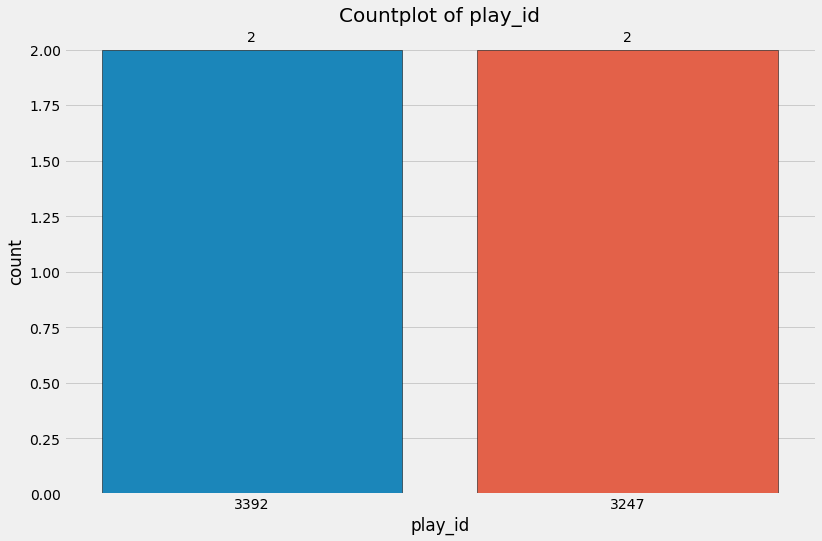

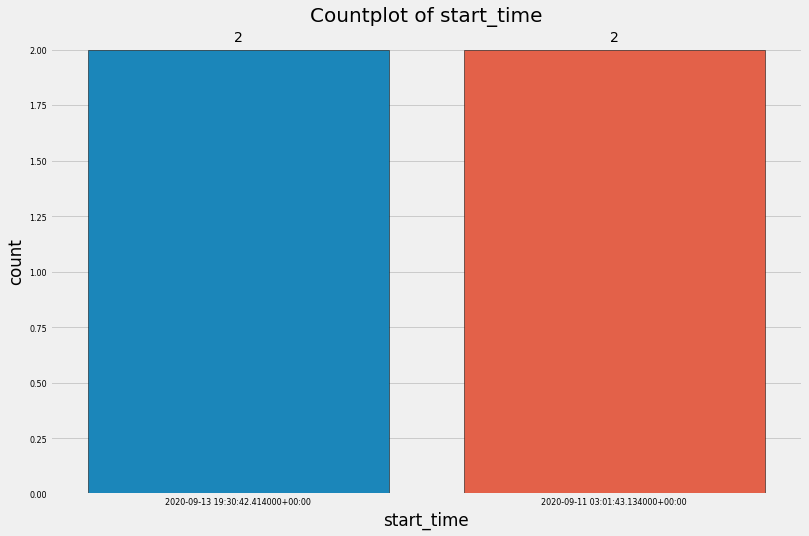

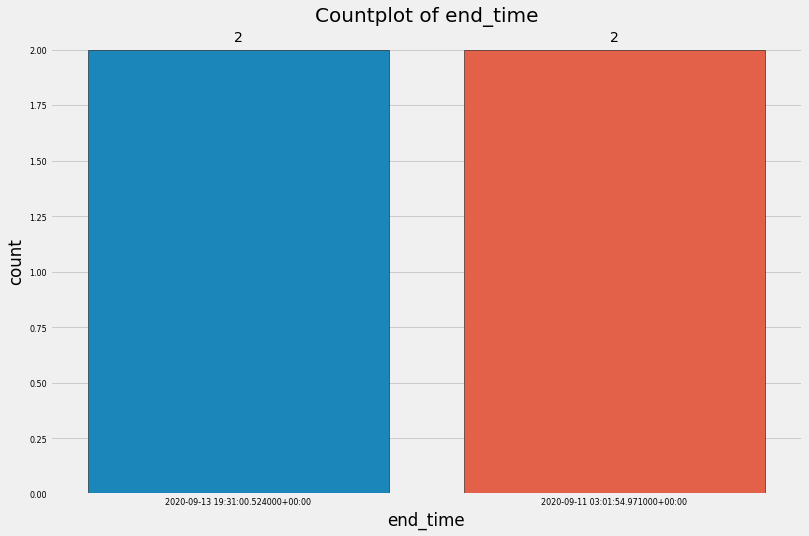

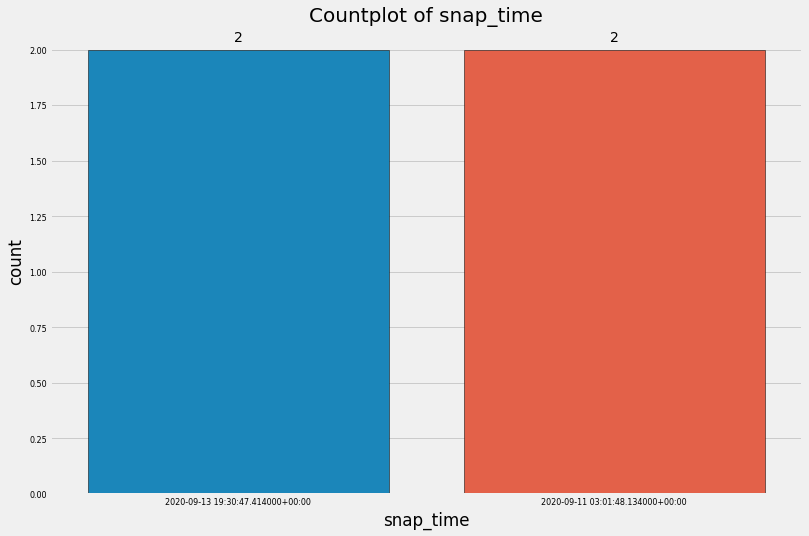

game_play     2
game_key      2
play_id       2
view          2
start_time    2
end_time      2
snap_time     2
dtype: int64

In [9]:
fast_eda(video_metadata_df)
video_metadata_df.nunique()

## Données label

DataFrame Head:


,contact_id,game_play,step,nfl_player_id_1,nfl_player_id_2,contact
0,58168_003392_0_38590_43854,58168_003392,0,38590,43854,0
1,58168_003392_0_38590_41257,58168_003392,0,38590,41257,0
2,58168_003392_0_38590_41944,58168_003392,0,38590,41944,0


DataFrame Tail:


,contact_id,game_play,step,nfl_player_id_1,nfl_player_id_2,contact
4721615,58582_003121_91_38557_G,58582_003121,91,38557,G,0
4721616,58582_003121_91_47872_G,58582_003121,91,47872,G,0
4721617,58582_003121_91_52619_G,58582_003121,91,52619,G,0


----------------------------------------------------------------------------------------------------
Missing values:


,0


----------------------------------------------------------------------------------------------------
Shape of DataFrame:

(4721618, 6)

----------------------------------------------------------------------------------------------------
DataFrame Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4721618 entries, 0 to 4721617
Data columns (total 6 columns):
 #   Column           Dtype 
---  ------           ----- 
 0   contact_id       object
 1   game_play        object
 2   step             int64 
 3   nfl_player_id_1  int64 
 4   nfl_player_id_2  object
 5   contact          int64 
dtypes: int64(3), object(3)
memory usage: 216.1+ MB
----------------------------------------------------------------------------------------------------
Describe DataFrame:



,count,mean,median,std,min,25%,50%,75%,max,skewness,kurtosis
step,4721618,40.745,38,26.835,0,19,38,59,172,0.672757,0.516473
nfl_player_id_1,4721618,42495.795,42667,4342.5,25511,40070,42667,45005,53985,-0.491096,1.473809
contact,4721618,0.014,0,0.116,0,0,0,0,1,8.378083,68.192274


----------------------------------------------------------------------------------------------------
DataFrame Correlation:



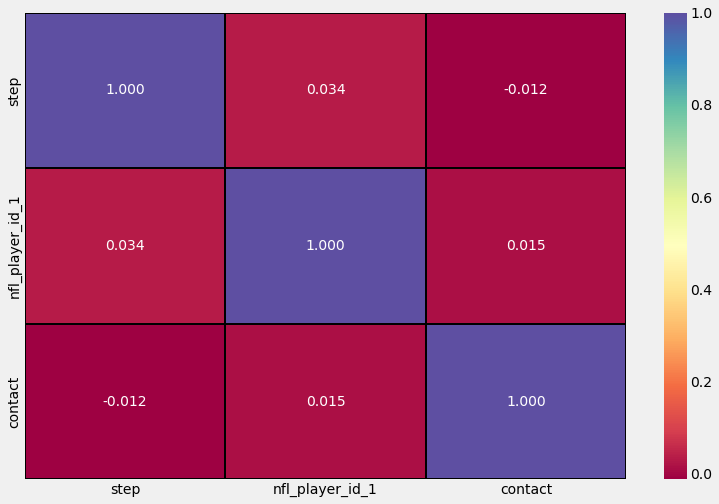

----------------------------------------------------------------------------------------------------
DataFrame Pairplot:



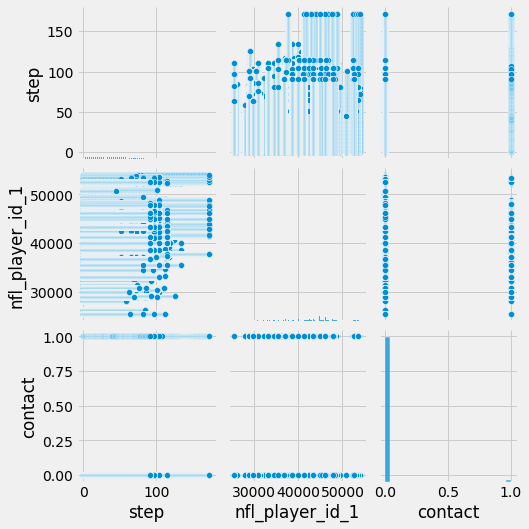

----------------------------------------------------------------------------------------------------
Histogram(s) & Boxplot(s):



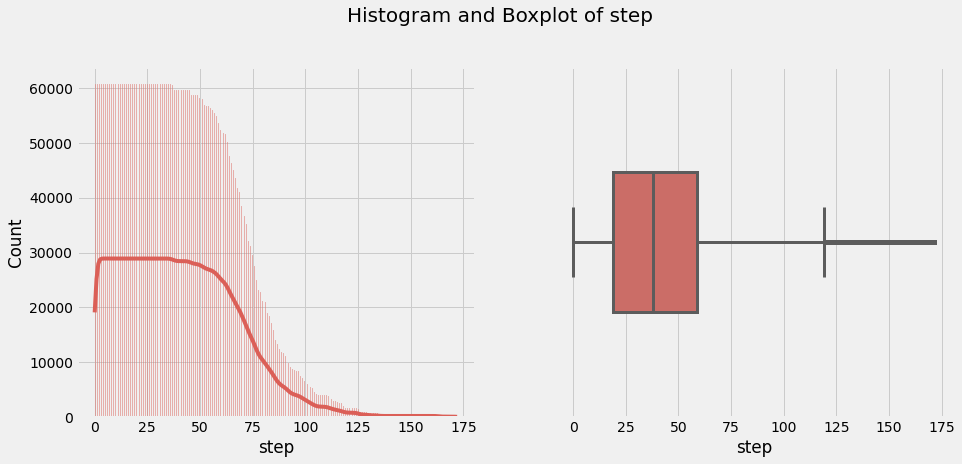

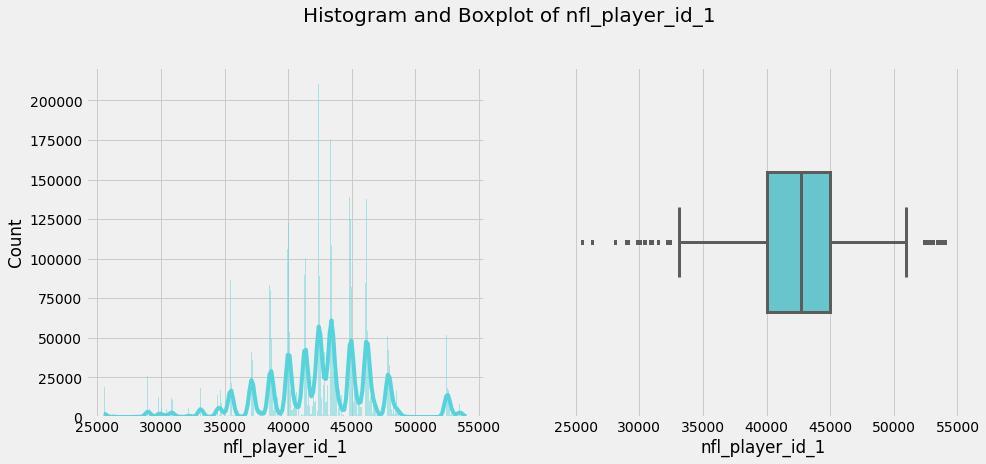

----------------------------------------------------------------------------------------------------
Countplot(s):



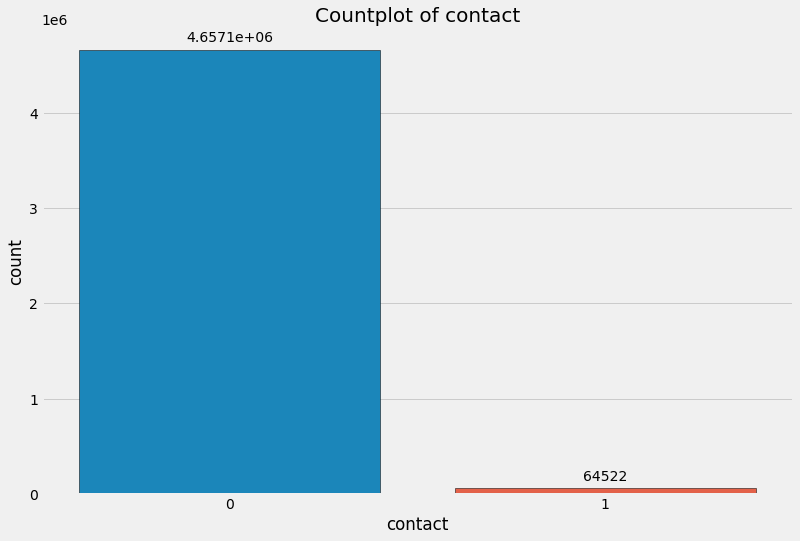

In [10]:
fast_eda(labels_df.drop(["datetime"], axis=1))

## Terrain

In [11]:
import matplotlib.patches as patches
import matplotlib.pylab as plt

def create_football_field(
    linenumbers=True,
    endzones=True,
    figsize=(12, 6.33),
    line_color="black",
    field_color="white",
    ez_color=None,
    ax=None,
    return_fig=False,
):
    """
    Function that plots the football field for viewing plays.
    Allows for showing or hiding endzones.
    """

    if ez_color is None:
        ez_color = field_color

    rect = patches.Rectangle(
        (0, 0),
        120,
        53.3,
        linewidth=0.1,
        edgecolor="r",
        facecolor=field_color,
        zorder=0,
    )

    if ax is None:
        fig, ax = plt.subplots(1, figsize=figsize)
    ax.add_patch(rect)
    ax.plot([10, 10, 10, 20, 20, 30, 30, 40, 40, 50, 50, 60, 60, 70, 70, 80,
              80, 90, 90, 100, 100, 110, 110, 120, 0, 0, 120, 120],
             [0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3,
              53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 53.3, 0, 0, 53.3],
             color=line_color)
    
    # Endzones
    if endzones:
        ez1 = patches.Rectangle(
            (0, 0),
            10,
            53.3,
            linewidth=0.1,
            edgecolor=line_color,
            facecolor=ez_color,
            alpha=0.6,
            zorder=0,
        )
        ez2 = patches.Rectangle(
            (110, 0),
            10,
            53.3,
            linewidth=0.1,
            edgecolor=line_color,
            facecolor=ez_color,
            alpha=0.6,
            zorder=0,
        )
        ax.add_patch(ez1)
        ax.add_patch(ez2)

    ax.axis("off")
    if linenumbers:
        for x in range(20, 110, 10):
            numb = x
            if x > 50:
                numb = 120 - x
            ax.text(
                x,
                5,
                str(numb - 10),
                horizontalalignment="center",
                fontsize=20,  # fontname='Arial',
                color=line_color,
            )
            ax.text(
                x - 0.95,
                53.3 - 5,
                str(numb - 10),
                horizontalalignment="center",
                fontsize=20,  # fontname='Arial',
                color=line_color,
                rotation=180,
            )
    if endzones:
        hash_range = range(11, 110)
    else:
        hash_range = range(1, 120)

    for x in hash_range:
        ax.plot([x, x], [0.4, 0.7], color=line_color)
        ax.plot([x, x], [53.0, 52.5], color=line_color)
        ax.plot([x, x], [22.91, 23.57], color=line_color)
        ax.plot([x, x], [29.73, 30.39], color=line_color)

    border = patches.Rectangle(
        (-5, -5),
        120 + 10,
        53.3 + 10,
        linewidth=0.1,
        edgecolor="orange",
        facecolor=line_color,
        alpha=0,
        zorder=0,
    )
    ax.add_patch(border)
    ax.set_xlim((-5, 125))
    ax.set_ylim((-5, 53.3 + 5))

    if return_fig:
        return fig, ax
    else:
        return ax

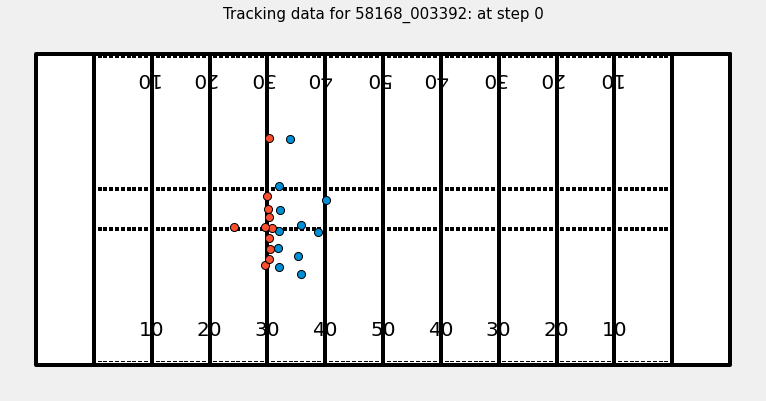

In [12]:
game_play = "58168_003392"
example_tracks = players_df.query("game_play == @game_play and step == 0")
ax = create_football_field()
for team, d in example_tracks.groupby("team"):
    ax.scatter(
        d["x_position"],
        d["y_position"],
        label=team,
        s=65,
        lw=1,
        edgecolors="black",
        zorder=5,
    )
ax.legend().remove()
ax.set_title(f"Tracking data for {game_play}: at step 0", fontsize=15)
plt.show()

## Vidéos

In [13]:
def join_helmets_contact(game_play, labels, helmets, meta, view="Sideline", fps=59.94):
    """
    Joins helmets and labels for a given game_play. Results can be used for visualizing labels.
    Returns a dataframe with the joint dataframe, duplicating rows if multiple contacts occur.
    """
    gp_labs = labels.query("game_play == @game_play").copy()
    gp_helms = helmets.query("game_play == @game_play").copy()

    start_time = meta.query("game_play == @game_play and view == @view")[
        "start_time"
    ].values[0]

    gp_helms["datetime"] = (
        pd.to_timedelta(gp_helms["frame"] * (1 / fps), unit="s") + start_time
    )
    gp_helms["datetime"] = pd.to_datetime(gp_helms["datetime"], utc=True)
    gp_helms["datetime_ngs"] = (
        pd.DatetimeIndex(gp_helms["datetime"] + pd.to_timedelta(50, "ms"))
        .floor("100ms")
        .values
    )
    gp_helms["datetime_ngs"] = pd.to_datetime(gp_helms["datetime_ngs"], utc=True)

    gp_labs["datetime_ngs"] = pd.to_datetime(gp_labs["datetime"], utc=True)

    gp = gp_helms.merge(
        gp_labs.query("contact == 1")[
            ["datetime_ngs", "nfl_player_id_1", "nfl_player_id_2", "contact_id"]
        ],
        left_on=["datetime_ngs", "nfl_player_id"],
        right_on=["datetime_ngs", "nfl_player_id_1"],
        how="left",
    )
    del gp_helms, gp_labs
    return gp

In [14]:
import os
import cv2
import subprocess
from IPython.display import Video, display
import pandas as pd
import numpy as np


def video_with_contact(video_path: str, baseline_boxes: pd.DataFrame, verbose=True) -> str:
    """
    Annotates a video with baseline model boxes.
    Helmet boxes are colored based on the contact label.
    """
    VIDEO_CODEC = "MP4V"
    HELMET_COLOR = (0, 0, 0)  # Black
    video_name = os.path.basename(video_path)
    if verbose:
        print(f"Running for {video_name}")
    baseline_boxes = baseline_boxes.copy()

    vidcap = cv2.VideoCapture(video_path)
    fps = vidcap.get(cv2.CAP_PROP_FPS)
    width = int(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    output_path = "contact_" + video_name
    tmp_output_path = "tmp_" + output_path
    output_video = cv2.VideoWriter(tmp_output_path, cv2.VideoWriter_fourcc(*VIDEO_CODEC), fps, (width, height))
    frame = 0
    while True:
        it_worked, img = vidcap.read()
        if not it_worked:
            break
        # We need to add 1 to the frame count to match the label frame index
        # that starts at 1
        frame += 1

        # Let's add a frame index to the video so we can track where we are
        img_name = video_name.replace('.mp4','')
        cv2.putText(img, img_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, HELMET_COLOR, thickness=1)        
        cv2.putText(img, str(frame), (1280 - 90, 720 - 20), cv2.FONT_HERSHEY_SIMPLEX, 1, HELMET_COLOR, thickness=1)

        # Now, add the boxes
        boxes = baseline_boxes.query("video == @video_name and frame == @frame")
        contact_players = boxes.dropna(subset=["nfl_player_id_2"]).query(
            'nfl_player_id_2 != "G"'
        )
        contact_ids = (
            contact_players["nfl_player_id_1"].astype("int").values.tolist()
            + contact_players["nfl_player_id_2"].astype("int").values.tolist()
        )
        for box in boxes.itertuples(index=False):

            if box.nfl_player_id_2 == "G":
                box_color = (0, 0, 255)  # Red
                box_thickness = 2
            elif int(box.nfl_player_id) in contact_ids:
                box_color = (0, 255, 0)  # green
                box_thickness = 2
                # Add line between players in contact
                if not np.isnan(float(box.nfl_player_id_2)):
                    player2 = int(box.nfl_player_id_2)
                    player2_row = boxes.query("nfl_player_id == @player2")
                    if len(player2_row) == 0:
                        # Player 2 is not in view
                        continue
                    p1 = (box.left + int(box.width / 2), box.top + int(box.height / 2))
                    p2 = (
                        player2_row.left.values[0] + int(player2_row.width.values[0] / 2),
                        player2_row.top.values[0] + int(player2_row.height.values[0] / 2),
                    )
                    cv2.line(img, p1, p2, color=(255, 0, 0), thickness=2)

            else:
                box_color = HELMET_COLOR
                box_thickness = 1

            # Draw lines between two boxes

            cv2.rectangle(img, (box.left, box.top), (box.left + box.width, box.top + box.height), box_color, thickness=box_thickness)
            cv2.putText(img, box.player_label, (box.left + 1, max(0, box.top - 20)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, HELMET_COLOR, thickness=1)

        output_video.write(img)
    output_video.release()
    # Not all browsers support the codec, we will re-load the file at tmp_output_path
    # and convert to a codec that is more broadly readable using ffmpeg
    if os.path.exists(output_path):
        os.remove(output_path)
    subprocess.run("ffmpeg -i {} -crf 18 -preset veryfast -hide_banner -loglevel error -vcodec libx264 {}".format(tmp_output_path, output_path).split(" "))
    os.remove(tmp_output_path)
    
    del tmp_output_path, output_video, boxes, contact_players, contact_ids

    return output_path

In [15]:
game_play = "58172_003247"
gp = join_helmets_contact(game_play, labels_df, helmets_df, video_metadata_df)

example_video = f"../input/nfl-player-contact-detection/train/{game_play}_Sideline.mp4"
output_video = video_with_contact(example_video, gp)

frac = 0.65  # scaling factor for display
display(Video(data=output_video, embed=True, height=int(720 * frac), width=int(1280 * frac)))
import gc
del example_video, output_video, gp, game_play, players_df, helmets_df, labels_df, video_metadata_df
gc.collect()

Running for 58172_003247_Sideline.mp4


OpenCV: FFMPEG: tag 0x5634504d/'MP4V' is not supported with codec id 12 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


1062

# Modélisation

In [16]:
import os
import sys
sys.path.append('/kaggle/input/timm-0-6-9/pytorch-image-models-master')
import glob
import numpy as np
import pandas as pd
import random
import math
import gc
import cv2
from tqdm import tqdm
import time
from functools import lru_cache
import torch
from torch import nn
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
from torch.cuda.amp import autocast, GradScaler
import timm
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt
from sklearn.metrics import matthews_corrcoef

In [17]:
CFG = {
    'seed': 42,
    'model': 'resnet50',
    'img_size': 256,
    'epochs': 10,
    'train_bs': 100, 
    'valid_bs': 64,
    'lr': 1e-3, 
    'weight_decay': 1e-6,
    'num_workers': 2
}

In [18]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

seed_everything(CFG['seed'])
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [19]:
def expand_contact_id(df):
    """
    Splits out contact_id into seperate columns.
    """
    df["game_play"] = df["contact_id"].str[:12]
    df["step"] = df["contact_id"].str.split("_").str[-3].astype("int")
    df["nfl_player_id_1"] = df["contact_id"].str.split("_").str[-2]
    df["nfl_player_id_2"] = df["contact_id"].str.split("_").str[-1]
    return df

labels = expand_contact_id(pd.read_csv("/kaggle/input/nfl-player-contact-detection/sample_submission.csv"))

test_tracking = pd.read_csv("/kaggle/input/nfl-player-contact-detection/test_player_tracking.csv")

test_helmets = pd.read_csv("/kaggle/input/nfl-player-contact-detection/test_baseline_helmets.csv")

test_video_metadata = pd.read_csv("/kaggle/input/nfl-player-contact-detection/test_video_metadata.csv")

In [20]:
!mkdir -p ../work/frames

for video in tqdm(test_helmets.video.unique()):
    if 'Endzone2' not in video:
        !ffmpeg -i /kaggle/input/nfl-player-contact-detection/test/{video} -q:v 2 -f image2 /kaggle/work/frames/{video}_%04d.jpg -hide_banner -loglevel error

100%|██████████| 4/4 [00:47<00:00, 11.80s/it]


In [21]:
def create_features(df, tr_tracking, merge_col="step", use_cols=["x_position", "y_position"]):
    output_cols = []
    df_combo = (
        df.astype({"nfl_player_id_1": "str"})
        .merge(
            tr_tracking.astype({"nfl_player_id": "str"})[
                ["game_play", merge_col, "nfl_player_id",] + use_cols
            ],
            left_on=["game_play", merge_col, "nfl_player_id_1"],
            right_on=["game_play", merge_col, "nfl_player_id"],
            how="left",
        )
        .rename(columns={c: c+"_1" for c in use_cols})
        .drop("nfl_player_id", axis=1)
        .merge(
            tr_tracking.astype({"nfl_player_id": "str"})[
                ["game_play", merge_col, "nfl_player_id"] + use_cols
            ],
            left_on=["game_play", merge_col, "nfl_player_id_2"],
            right_on=["game_play", merge_col, "nfl_player_id"],
            how="left",
        )
        .drop("nfl_player_id", axis=1)
        .rename(columns={c: c+"_2" for c in use_cols})
        .sort_values(["game_play", merge_col, "nfl_player_id_1", "nfl_player_id_2"])
        .reset_index(drop=True)
    )
    output_cols += [c+"_1" for c in use_cols]
    output_cols += [c+"_2" for c in use_cols]
    
    if ("x_position" in use_cols) & ("y_position" in use_cols):
        index = df_combo['x_position_2'].notnull()
        
        distance_arr = np.full(len(index), np.nan)
        tmp_distance_arr = np.sqrt(
            np.square(df_combo.loc[index, "x_position_1"] - df_combo.loc[index, "x_position_2"])
            + np.square(df_combo.loc[index, "y_position_1"]- df_combo.loc[index, "y_position_2"])
        )
        
        distance_arr[index] = tmp_distance_arr
        df_combo['distance'] = distance_arr
        output_cols += ["distance"]
        
    df_combo['G_flug'] = (df_combo['nfl_player_id_2']=="G")
    output_cols += ["G_flug"]
    return df_combo, output_cols


use_cols = [
    'x_position', 'y_position', 'speed', 'distance',
    'direction', 'orientation', 'acceleration', 'sa'
]

test, feature_cols = create_features(labels, test_tracking, use_cols=use_cols)
test

,contact_id,contact,game_play,step,nfl_player_id_1,nfl_player_id_2,x_position_1,y_position_1,speed_1,distance_1,direction_1,orientation_1,acceleration_1,sa_1,x_position_2,y_position_2,speed_2,distance_2,direction_2,orientation_2,acceleration_2,sa_2,distance,G_flug
0,58168_003392_0_37084_37211,0,58168_003392,0,37084,37211,41.90,20.08,0.54,0.06,252.69,262.31,0.92,0.90,39.59,17.07,0.53,0.05,134.84,84.73,1.43,1.42,3.794232,False
1,58168_003392_0_37084_38556,0,58168_003392,0,37084,38556,41.90,20.08,0.54,0.06,252.69,262.31,0.92,0.90,41.93,30.61,0.67,0.05,232.50,227.00,1.82,1.61,10.530043,False
2,58168_003392_0_37084_38567,0,58168_003392,0,37084,38567,41.90,20.08,0.54,0.06,252.69,262.31,0.92,0.90,40.37,19.88,0.66,0.07,136.70,88.92,0.90,0.89,1.543017,False
3,58168_003392_0_37084_38590,0,58168_003392,0,37084,38590,41.90,20.08,0.54,0.06,252.69,262.31,0.92,0.90,40.33,25.28,0.52,0.06,141.08,100.37,0.59,0.58,5.431841,False
4,58168_003392_0_37084_39947,0,58168_003392,0,37084,39947,41.90,20.08,0.54,0.06,252.69,262.31,0.92,0.90,40.11,26.73,0.99,0.09,163.38,90.69,1.68,1.64,6.886697,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49583,58172_003247_125_52521_52939,0,58172_003247,125,52521,52939,23.44,4.04,1.41,0.15,163.22,185.42,0.75,-0.58,37.94,2.10,2.29,0.24,211.73,215.11,2.43,-2.43,14.629204,False
49584,58172_003247_125_52521_G,0,58172_003247,125,52521,G,23.44,4.04,1.41,0.15,163.22,185.42,0.75,-0.58,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True
49585,58172_003247_125_52852_52939,0,58172_003247,125,52852,52939,32.67,2.18,2.34,0.24,113.19,119.09,1.03,-0.97,37.94,2.10,2.29,0.24,211.73,215.11,2.43,-2.43,5.270607,False
49586,58172_003247_125_52852_G,0,58172_003247,125,52852,G,32.67,2.18,2.34,0.24,113.19,119.09,1.03,-0.97,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True


In [22]:
test_filtered = test.query('not distance>2').reset_index(drop=True)
test_filtered['frame'] = (test_filtered['step']/10*59.94+5*59.94).astype('int')+1
test_filtered

,contact_id,contact,game_play,step,nfl_player_id_1,nfl_player_id_2,x_position_1,y_position_1,speed_1,distance_1,direction_1,orientation_1,acceleration_1,sa_1,x_position_2,y_position_2,speed_2,distance_2,direction_2,orientation_2,acceleration_2,sa_2,distance,G_flug,frame
0,58168_003392_0_37084_38567,0,58168_003392,0,37084,38567,41.90,20.08,0.54,0.06,252.69,262.31,0.92,0.90,40.37,19.88,0.66,0.07,136.70,88.92,0.90,0.89,1.543017,False,300
1,58168_003392_0_37084_G,0,58168_003392,0,37084,G,41.90,20.08,0.54,0.06,252.69,262.31,0.92,0.90,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,300
2,58168_003392_0_37211_46445,0,58168_003392,0,37211,46445,39.59,17.07,0.53,0.05,134.84,84.73,1.43,1.42,40.34,18.08,1.10,0.10,148.93,92.39,2.03,2.03,1.258014,False,300
3,58168_003392_0_37211_G,0,58168_003392,0,37211,G,39.59,17.07,0.53,0.05,134.84,84.73,1.43,1.42,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,300
4,58168_003392_0_38556_G,0,58168_003392,0,38556,G,41.93,30.61,0.67,0.05,232.50,227.00,1.82,1.61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6626,58172_003247_125_48241_G,0,58172_003247,125,48241,G,33.86,-1.28,0.79,0.08,148.92,130.02,1.40,-0.06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,1049
6627,58172_003247_125_48335_G,0,58172_003247,125,48335,G,44.74,3.16,4.72,0.48,247.51,255.55,1.34,-1.08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,1049
6628,58172_003247_125_52521_G,0,58172_003247,125,52521,G,23.44,4.04,1.41,0.15,163.22,185.42,0.75,-0.58,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,1049
6629,58172_003247_125_52852_G,0,58172_003247,125,52852,G,32.67,2.18,2.34,0.24,113.19,119.09,1.03,-0.97,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,1049


In [23]:
del test, labels, test_tracking
gc.collect()

81

In [24]:
train_aug = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.ShiftScaleRotate(p=0.5),
    A.RandomBrightnessContrast(brightness_limit=(-0.1, 0.1), contrast_limit=(-0.1, 0.1), p=0.5),
    A.Normalize(mean=[0.], std=[1.]),
    ToTensorV2()
])

valid_aug = A.Compose([
    A.Normalize(mean=[0.], std=[1.]),
    ToTensorV2()
])

In [25]:
video2helmets = {}
test_helmets_new = test_helmets.set_index('video')
for video in tqdm(test_helmets.video.unique()):
    video2helmets[video] = test_helmets_new.loc[video].reset_index(drop=True)
    
del test_helmets, test_helmets_new
gc.collect()

100%|██████████| 4/4 [00:00<00:00, 256.41it/s]


23

In [26]:
video2frames = {}

for game_play in tqdm(test_video_metadata.game_play.unique()):
    for view in ['Endzone', 'Sideline']:
        video = game_play + f'_{view}.mp4'
        video2frames[video] = max(list(map(lambda x:int(x.split('_')[-1].split('.')[0]), \
                                           glob.glob(f'/kaggle/work/frames/{video}*'))))

100%|██████████| 2/2 [00:00<00:00, 63.13it/s]


In [27]:
class MyDataset(Dataset):
    def __init__(self, df, aug=valid_aug, mode='train'):
        self.df = df
        self.frame = df.frame.values
        self.feature = df[feature_cols].fillna(-1).values
        self.players = df[['nfl_player_id_1','nfl_player_id_2']].values
        self.game_play = df.game_play.values
        self.aug = aug
        self.mode = mode
        
    def __len__(self):
        return len(self.df)
    
    # @lru_cache(1024)
    # def read_img(self, path):
    #     return cv2.imread(path, 0)
   
    def __getitem__(self, idx):   
        window = 24
        frame = self.frame[idx]
        
        if self.mode == 'train':
            frame = frame + random.randint(-6, 6)

        players = []
        for p in self.players[idx]:
            if p == 'G':
                players.append(p)
            else:
                players.append(int(p))
        
        imgs = []
        for view in ['Endzone', 'Sideline']:
            video = self.game_play[idx] + f'_{view}.mp4'

            tmp = video2helmets[video]
#             tmp = tmp.query('@frame-@window<=frame<=@frame+@window')
            tmp[tmp['frame'].between(frame-window, frame+window)]
            tmp = tmp[tmp.nfl_player_id.isin(players)]#.sort_values(['nfl_player_id', 'frame'])
            tmp_frames = tmp.frame.values
            tmp = tmp.groupby('frame')[['left','width','top','height']].mean()
#0.002s

            bboxes = []
            for f in range(frame-window, frame+window+1, 1):
                if f in tmp_frames:
                    x, w, y, h = tmp.loc[f][['left','width','top','height']]
                    bboxes.append([x, w, y, h])
                else:
                    bboxes.append([np.nan, np.nan, np.nan, np.nan])
            bboxes = pd.DataFrame(bboxes).interpolate(limit_direction='both').values
            bboxes = bboxes[::4]

            if bboxes.sum() > 0:
                flag = 1
            else:
                flag = 0
#0.03s
                    
            for i, f in enumerate(range(frame-window, frame+window+1, 4)):
                img_new = np.zeros((256, 256), dtype=np.float32)

                if flag == 1 and f <= video2frames[video]:
                    img = cv2.imread(f'/kaggle/work/frames/{video}_{f:04d}.jpg', 0)

                    x, w, y, h = bboxes[i]

                    img = img[int(y+h/2)-128:int(y+h/2)+128,int(x+w/2)-128:int(x+w/2)+128].copy()
                    img_new[:img.shape[0], :img.shape[1]] = img
                    
                imgs.append(img_new)
#0.06s
                
        feature = np.float32(self.feature[idx])

        img = np.array(imgs).transpose(1, 2, 0)    
        img = self.aug(image=img)["image"]
        label = np.float32(self.df.contact.values[idx])

        return img, feature, label

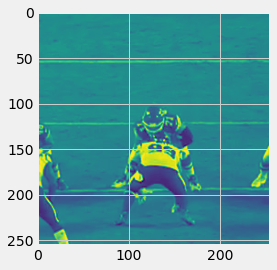

(torch.Size([26, 256, 256]),
 array([4.1900002e+01, 2.0080000e+01, 5.4000002e-01, 5.9999999e-02,
        2.5269000e+02, 2.6231000e+02, 9.2000002e-01, 8.9999998e-01,
        4.0369999e+01, 1.9879999e+01, 6.6000003e-01, 7.0000000e-02,
        1.3670000e+02, 8.8919998e+01, 8.9999998e-01, 8.8999999e-01,
        1.5430166e+00, 0.0000000e+00], dtype=float32),
 0.0)

In [28]:
img, feature, label = MyDataset(test_filtered, valid_aug, 'test')[0]
plt.imshow(img.permute(1,2,0)[:,:,0])
plt.show()
img.shape, feature, label

In [29]:
class Model(nn.Module):
    def __init__(self):
        super(Model, self).__init__()
        self.backbone = timm.create_model(CFG['model'], pretrained=False, num_classes=500, in_chans=13)
        self.mlp = nn.Sequential(
            nn.Linear(18, 64),
            nn.LayerNorm(64),
            nn.ReLU(),
            nn.Dropout(0.2),
            # nn.Linear(64, 64),
            # nn.LayerNorm(64),
            # nn.ReLU(),
            # nn.Dropout(0.2)
        )
        self.fc = nn.Linear(64+500*2, 1)

    def forward(self, img, feature):
        b, c, h, w = img.shape
        img = img.reshape(b*2, c//2, h, w)
        img = self.backbone(img).reshape(b, -1)
        feature = self.mlp(feature)
        y = self.fc(torch.cat([img, feature], dim=1))
        return y

In [30]:
test_set = MyDataset(test_filtered, valid_aug, 'test')
test_loader = DataLoader(test_set, batch_size=CFG['valid_bs'], shuffle=False, num_workers=CFG['num_workers'], pin_memory=True)

model = Model().to(device)
model.load_state_dict(torch.load('/kaggle/input/nfl-exp1/resnet50_fold0.pt'))

model.eval()
    
y_pred = []
with torch.no_grad():
    tk = tqdm(test_loader, total=len(test_loader))
    for step, batch in enumerate(tk):
        if(step % 4 != 3):
            img, feature, label = [x.to(device) for x in batch]
            output1 = model(img, feature).squeeze(-1)
            output2 = model(img.flip(-1), feature).squeeze(-1)
            
            y_pred.extend(0.2*(output1.sigmoid().cpu().numpy()) + 0.8*(output2.sigmoid().cpu().numpy()))
        else:
            img, feature, label = [x.to(device) for x in batch]
            output = model(img.flip(-1), feature).squeeze(-1)
            y_pred.extend(output.sigmoid().cpu().numpy())    

y_pred = np.array(y_pred)

100%|██████████| 104/104 [16:44<00:00,  9.66s/it]


In [31]:
th = 0.29

test_filtered['contact'] = (y_pred >= th).astype('int')

sub = pd.read_csv('/kaggle/input/nfl-player-contact-detection/sample_submission.csv')

sub = sub.drop("contact", axis=1).merge(test_filtered[['contact_id', 'contact']], how='left', on='contact_id')
sub['contact'] = sub['contact'].fillna(0).astype('int')

sub[["contact_id", "contact"]].to_csv("submission.csv", index=False)

sub.head()

,contact_id,contact
0,58168_003392_0_38590_43854,0
1,58168_003392_0_38590_41257,0
2,58168_003392_0_38590_41944,0
3,58168_003392_0_38590_42386,0
4,58168_003392_0_38590_47944,0
